In [85]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.preprocessing import LabelEncoder
from scipy.stats import skew
from tqdm import tqdm
from pandas_profiling import ProfileReport
import warnings
warnings.filterwarnings("ignore")

Weather forecasting is the application of science and technology to predict the conditions of the atmosphere for a given location and time. Weather forecasts are made by collecting quantitative data about the current state of the atmosphere at a given place and using meteorology to project how the atmosphere will change

Rain Dataset is to predict whether or not it will rain tomorrow. The Dataset contains about 10 years of daily weather observations of different locations in Australia. Here, predict two things:

Problem Statement: 
* a) Design a predictive model with the use of machine learning algorithms to forecast whether or not it will rain tomorrow.


In [40]:
df = pd.read_csv("Rainfall Weather Forecasting.csv")

In [41]:
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


In [42]:
df.isnull().sum()

Date                0
Location            0
MinTemp            75
MaxTemp            60
Rainfall          240
Evaporation      3512
Sunshine         3994
WindGustDir       991
WindGustSpeed     991
WindDir9am        829
WindDir3pm        308
WindSpeed9am       76
WindSpeed3pm      107
Humidity9am        59
Humidity3pm       102
Pressure9am      1309
Pressure3pm      1312
Cloud9am         2421
Cloud3pm         2455
Temp9am            56
Temp3pm            96
RainToday         240
RainTomorrow      239
dtype: int64

I can see that in this dataset have many null values firstly i can study the data then fill null values according to their columns type

In [43]:
profile = ProfileReport(df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

This is pandas profiling this help me to get full details of my project for analysis and EDA process this is very helpfull and very less time consume

In [44]:
print(df.dtypes)
print(df.isnull().sum())

Date              object
Location          object
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
dtype: object
Date                0
Location            0
MinTemp            75
MaxTemp            60
Rainfall          240
Evaporation      3512
Sunshine         3994
WindGustDir       991
WindGustSpeed     991
WindDir9am        829
WindDir3pm        308
WindSpeed9am       76
WindSpeed3pm      107
Humidity9am        59
Humidity3pm       102
Pressure9am      1309
Pressure3pm      1312
Cloud9am         2421
Cloud3pm       

In [45]:
null_columns = ["MinTemp", "MaxTemp", "Rainfall", "Evaporation", "Sunshine", "WindGustSpeed","WindSpeed3pm", "Humidity3pm",
                "WindSpeed9am", "Humidity9am", "Pressure9am", "Pressure3pm", "Cloud9am", "Cloud3pm",
                "Temp9am", "Temp3pm"]
null_columns_obj = ["WindGustDir", "WindDir9am", "WindDir3pm", "RainToday", "RainTomorrow"]

Firstly i can seperate objects columns and int columns after seperation i can use for loop for fill null values according to their column and data type

In [54]:
for i in null_columns:
    df[i] = df[i].fillna(df[i].mean())

for i in null_columns_obj:
    df[i] = df[i].fillna([j for j in df[i].mode()][0])

In [55]:
df.isnull().sum()

Date             0
Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
dtype: int64

Now our null values have been fill and ready for other process 

100%|██████████| 23/23 [00:15<00:00,  1.47it/s]


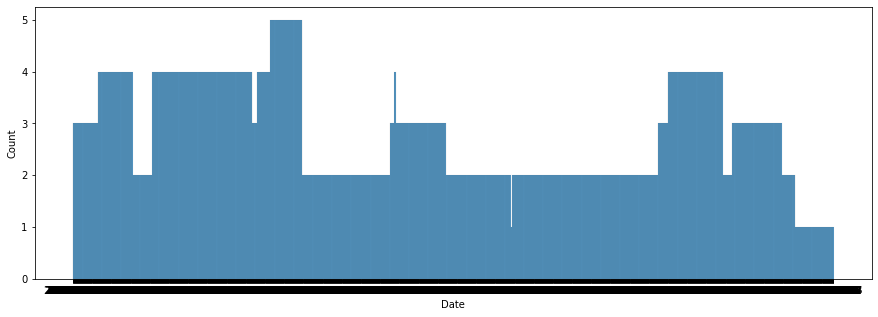

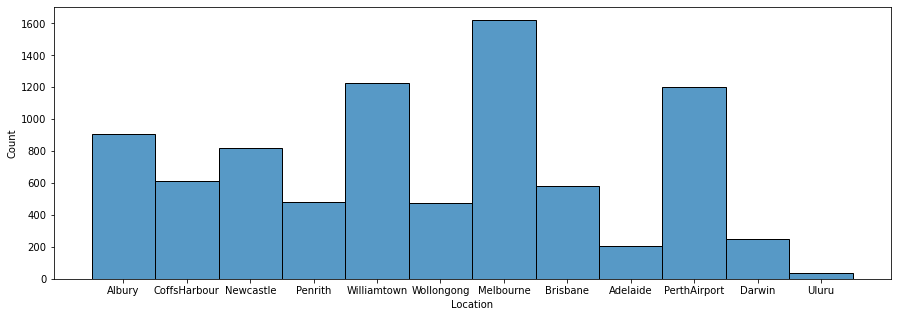

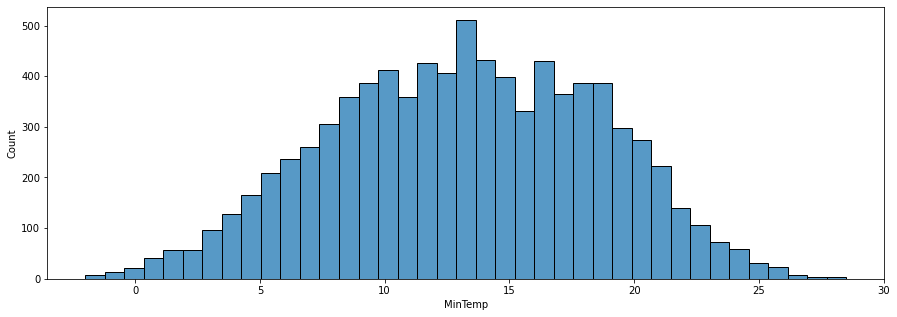

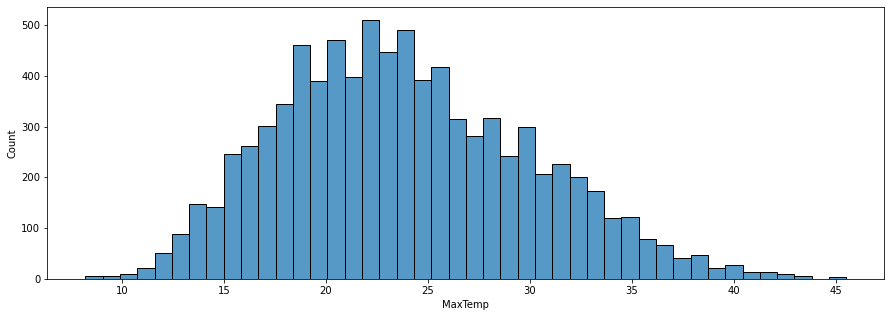

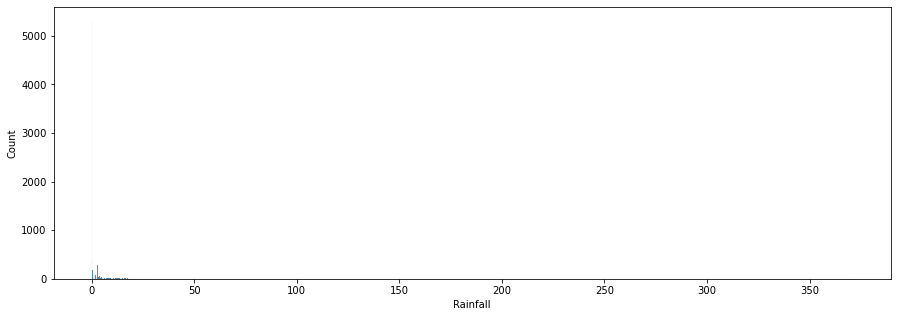

...

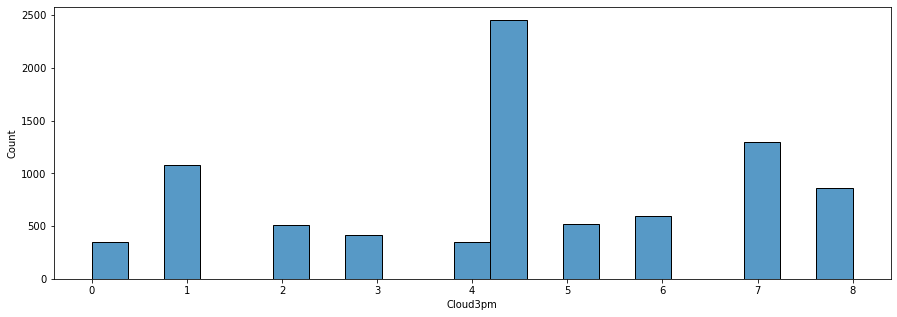

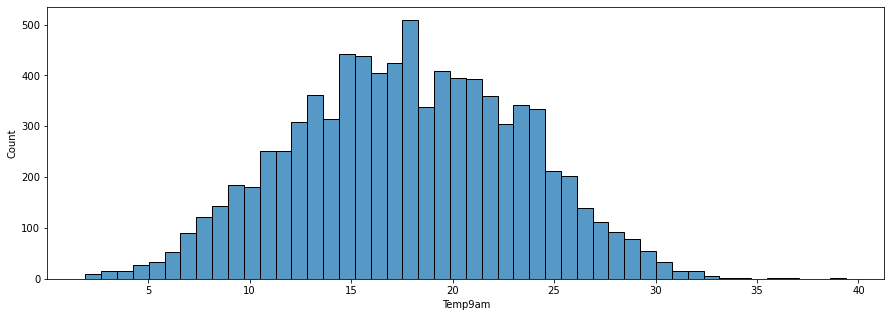

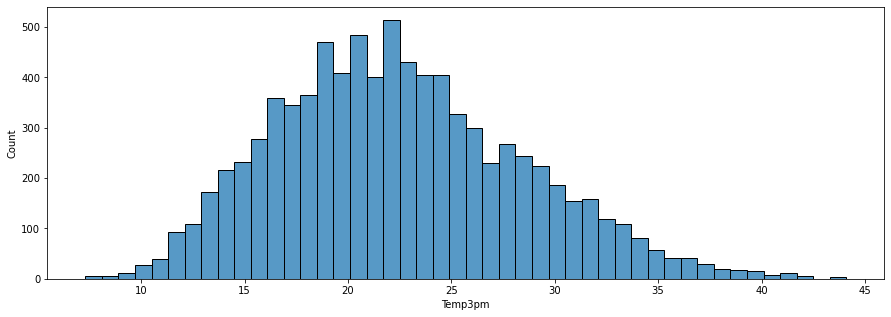

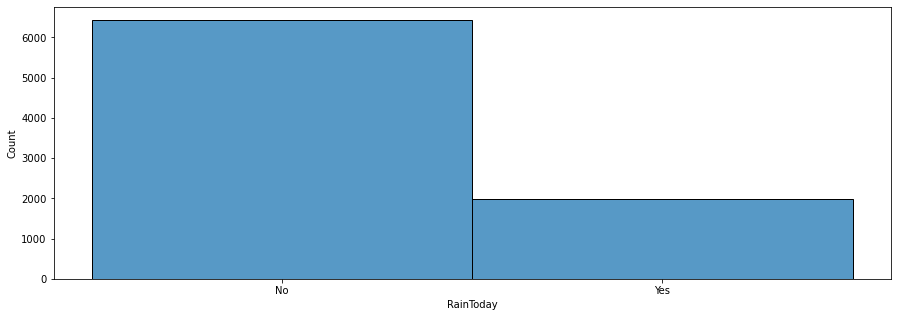

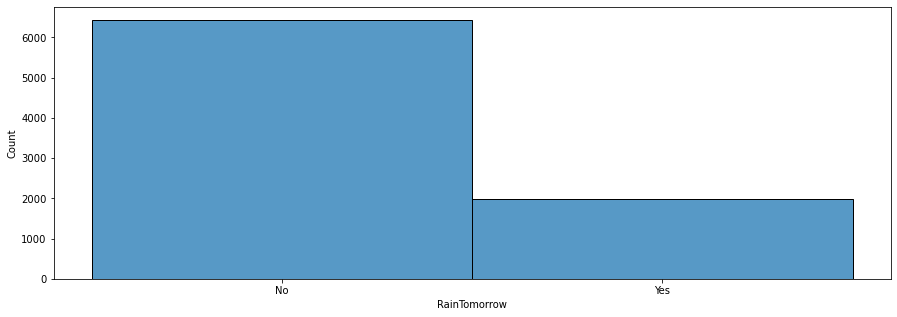

In [67]:
for i in tqdm(df.columns):
    plt.figure(figsize = (15,5))
    sns.histplot(x = i, data = df)

In this analysis with the help of histplot i can check all the columns in graph and assume in which column which data is high and which is low

100%|██████████| 16/16 [01:43<00:00,  6.47s/it]


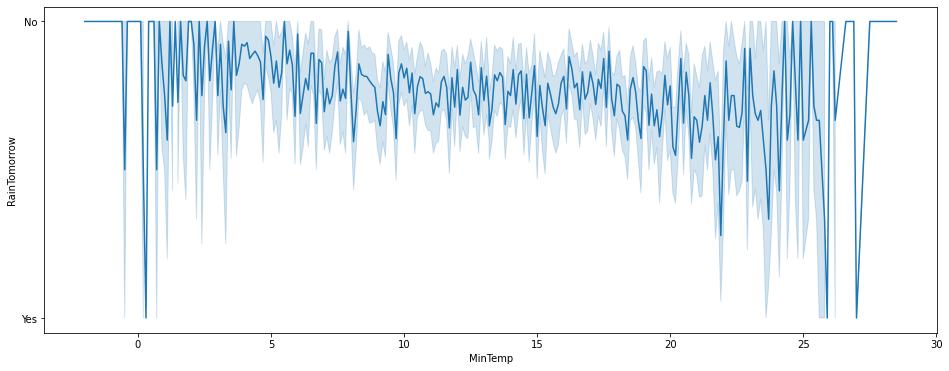

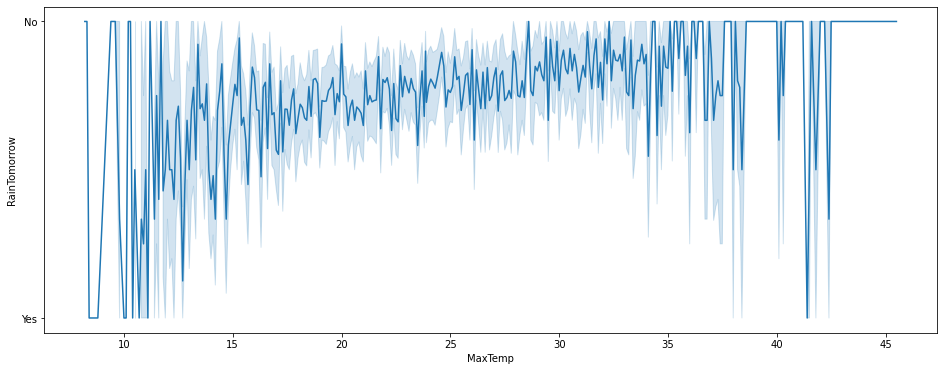

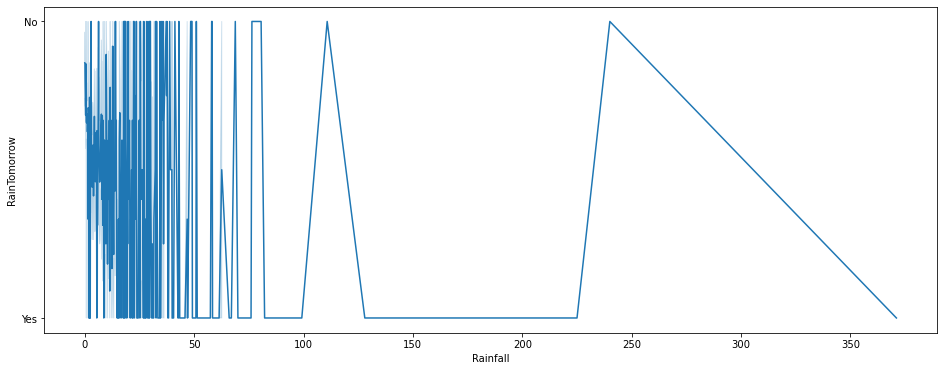

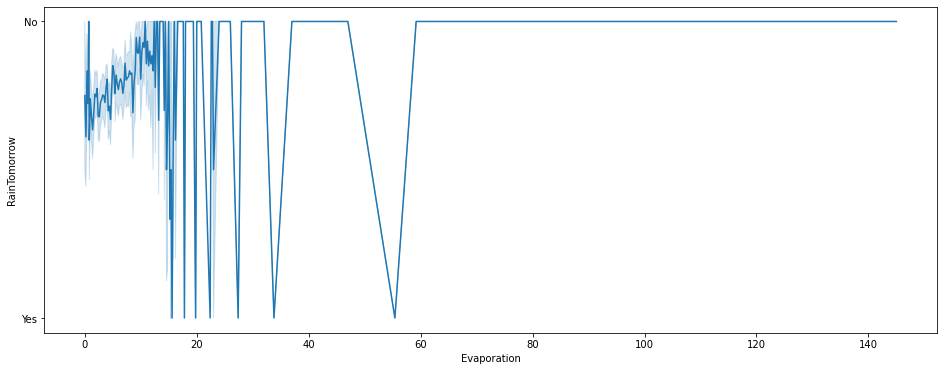

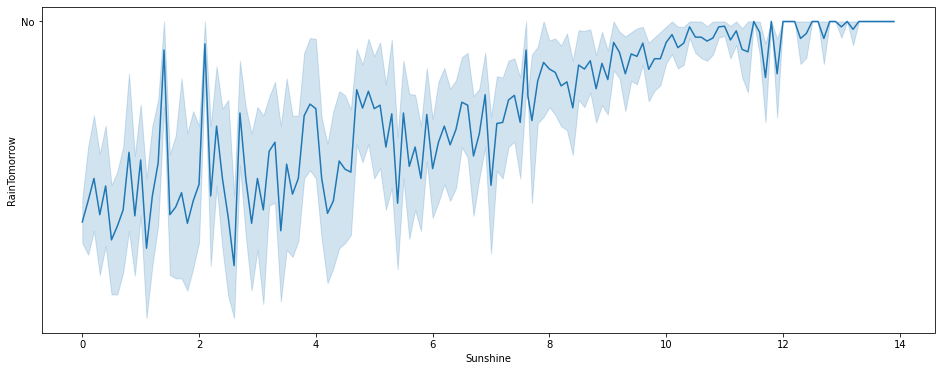

...

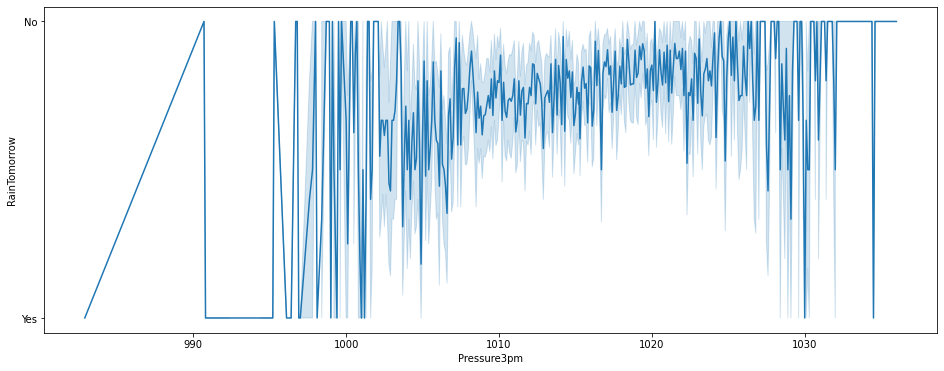

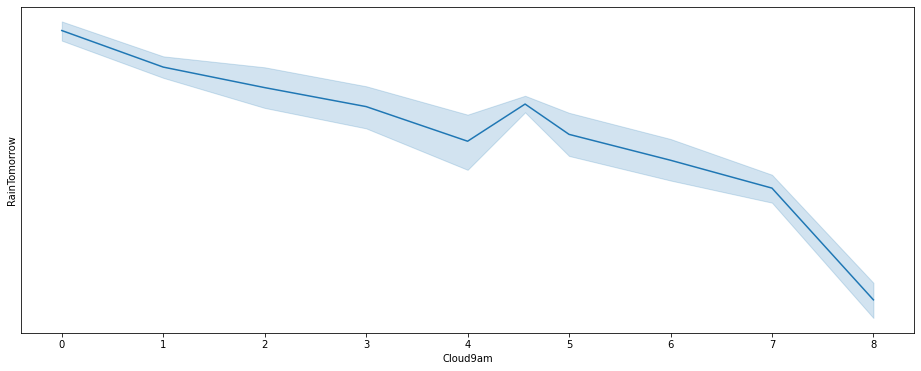

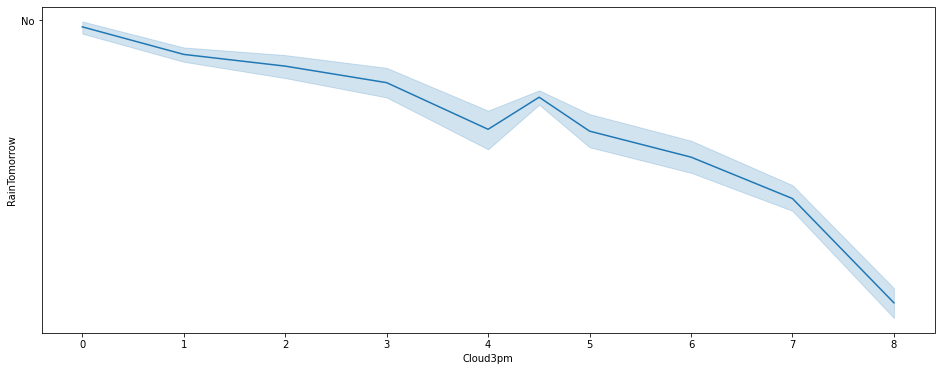

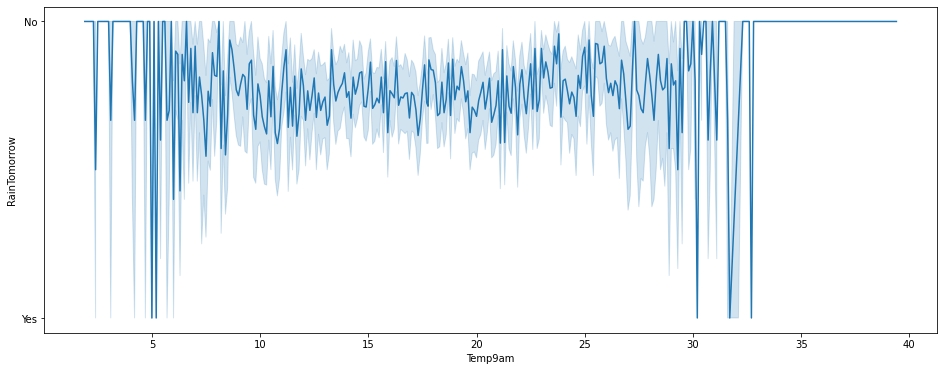

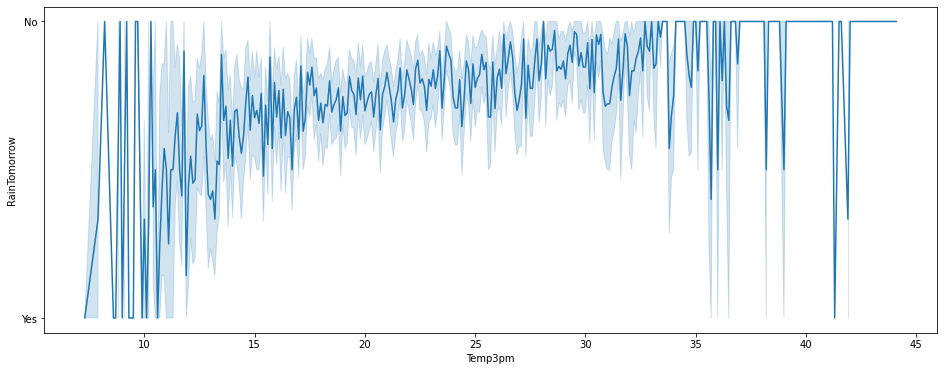

In [74]:
for i in tqdm(null_columns):
    plt.figure(figsize = (16,6))
    sns.lineplot(x = i, y = 'RainTomorrow', data = df)

In this analysis with the help of lineplot i can compare my target variable with my features column and check the corelation and take dicission which column is good for modeling my data

<AxesSubplot:>

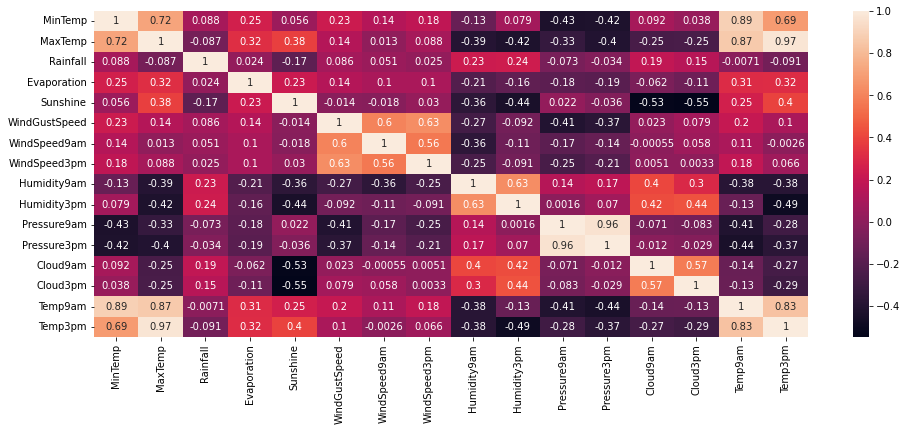

In [75]:
plt.figure(figsize = (16,6))
sns.heatmap(df.corr(), annot = True)

With the help of heatmap i can check corelation of the column and get detail which column highly positive or negtive corelated with each other and take decission

array([[<AxesSubplot:title={'center':'MinTemp'}>,
        <AxesSubplot:title={'center':'MaxTemp'}>,
        <AxesSubplot:title={'center':'Rainfall'}>,
        <AxesSubplot:title={'center':'Evaporation'}>],
       [<AxesSubplot:title={'center':'Sunshine'}>,
        <AxesSubplot:title={'center':'WindGustSpeed'}>,
        <AxesSubplot:title={'center':'WindSpeed9am'}>,
        <AxesSubplot:title={'center':'WindSpeed3pm'}>],
       [<AxesSubplot:title={'center':'Humidity9am'}>,
        <AxesSubplot:title={'center':'Humidity3pm'}>,
        <AxesSubplot:title={'center':'Pressure9am'}>,
        <AxesSubplot:title={'center':'Pressure3pm'}>],
       [<AxesSubplot:title={'center':'Cloud9am'}>,
        <AxesSubplot:title={'center':'Cloud3pm'}>,
        <AxesSubplot:title={'center':'Temp9am'}>,
        <AxesSubplot:title={'center':'Temp3pm'}>],
       [<AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>],
       [<AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>]],
      dty

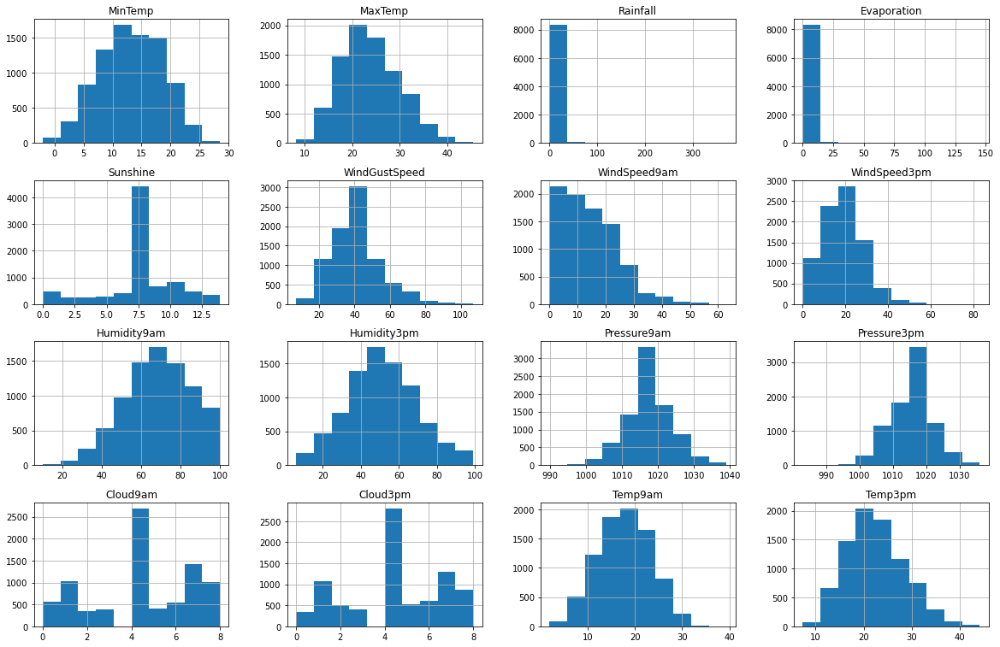

In [77]:
df.hist(figsize=(20,20),grid=True,layout=(6,4))

In [78]:
df.skew()

MinTemp          -0.089989
MaxTemp           0.380654
Rainfall         13.218403
Evaporation      14.023948
Sunshine         -0.716525
WindGustSpeed     0.757000
WindSpeed9am      0.960591
WindSpeed3pm      0.494217
Humidity9am      -0.256743
Humidity3pm       0.118281
Pressure9am      -0.024082
Pressure3pm      -0.010214
Cloud9am         -0.366503
Cloud3pm         -0.276294
Temp9am          -0.014748
Temp3pm           0.397331
dtype: float64

we can see that skewness is present in Rainfall, Evaporation and other 2 columns so firstly we can remove skewnwss form those columns after it we can go for removing outlyers 

In [80]:
skew_col = ['Rainfall', 'Evaporation', "WindSpeed9am", "WindGustSpeed"]

In [81]:
for i in skew_col:
    df[i]=np.cbrt(df[i])

In [83]:
df['Rainfall']=np.cbrt(df['Rainfall'])

In [84]:
df.skew()

MinTemp         -0.089989
MaxTemp          0.380654
Rainfall         0.676161
Evaporation      0.176211
Sunshine        -0.716525
WindGustSpeed   -0.022921
WindSpeed9am    -1.220228
WindSpeed3pm     0.494217
Humidity9am     -0.256743
Humidity3pm      0.118281
Pressure9am     -0.024082
Pressure3pm     -0.010214
Cloud9am        -0.366503
Cloud3pm        -0.276294
Temp9am         -0.014748
Temp3pm          0.397331
dtype: float64

Now skewnwss have been remove from this columns now we can go for removing outlyers

In [88]:
le = LabelEncoder()
for i in df.columns:
    if df[i].dtypes=='object':
        df[i] =le.fit_transform(df[i].values.reshape(-1,1))
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8425 non-null   int32  
 1   Location       8425 non-null   int32  
 2   MinTemp        8425 non-null   float64
 3   MaxTemp        8425 non-null   float64
 4   Rainfall       8425 non-null   float64
 5   Evaporation    8425 non-null   float64
 6   Sunshine       8425 non-null   float64
 7   WindGustDir    8425 non-null   int32  
 8   WindGustSpeed  8425 non-null   float64
 9   WindDir9am     8425 non-null   int32  
 10  WindDir3pm     8425 non-null   int32  
 11  WindSpeed9am   8425 non-null   float64
 12  WindSpeed3pm   8425 non-null   float64
 13  Humidity9am    8425 non-null   float64
 14  Humidity3pm    8425 non-null   float64
 15  Pressure9am    8425 non-null   float64
 16  Pressure3pm    8425 non-null   float64
 17  Cloud9am       8425 non-null   float64
 18  Cloud3pm

With the help of lable encoder we can change our object data to int or numeric data for removing outlyers and for data modeling also

In [89]:
from scipy.stats import zscore
z = np.abs(zscore(df))
z

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,1.517879,1.515776,0.038425,1.570089e-01,0.945582,0.184155,1.257472e-15,1.229643,0.383597,1.249535,...,0.189439,1.597406,1.584003,1.308665,1.413459,3.862851e-16,0.153712,0.108138,0.556099,0.556282
1,1.516709,1.515776,1.076989,2.028121e-01,0.750336,0.184155,1.257472e-15,1.442303,0.383597,0.276260,...,1.420268,1.433568,1.121880,1.196072,0.000000,3.862851e-16,0.100217,0.312348,0.556099,0.556282
2,1.515538,1.515776,0.054526,3.009450e-01,0.750336,0.184155,1.257472e-15,1.654964,0.518289,1.249535,...,1.777981,1.160505,1.599939,1.051309,0.000000,1.088680e+00,0.577390,0.127334,0.556099,0.556282
3,1.514367,1.515776,0.742365,6.771214e-01,0.750336,0.184155,1.257472e-15,0.684299,1.267087,0.377652,...,1.360650,1.925081,0.006411,0.391836,0.000000,3.862851e-16,0.060269,0.682376,0.556099,0.556282
4,1.513197,1.515776,0.800625,1.380408e+00,1.044624,0.184155,1.257472e-15,1.229643,0.173684,1.366114,...,0.845246,0.996668,1.090010,1.485596,1.001777,1.520830e+00,0.006773,1.220599,0.556099,0.556282
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,1.993013,1.013895,1.932140,7.523137e-02,0.750336,0.184155,1.257472e-15,1.534940,0.610540,0.377652,...,1.002937,1.488181,1.109058,0.814518,0.000000,3.862851e-16,1.366273,0.007221,0.556099,0.556282
8421,1.994184,1.013895,1.783418,2.355231e-01,0.750336,0.184155,1.257472e-15,0.258979,1.477841,0.377652,...,0.704843,1.652018,0.933770,0.621501,0.000000,3.862851e-16,1.223619,0.345987,0.556099,0.556282
8422,1.995355,1.013895,1.448794,4.972110e-01,0.750336,0.184155,1.257472e-15,0.896959,0.122781,0.377652,...,0.883699,1.488181,0.535388,0.251553,0.000000,3.862851e-16,0.938310,0.615099,0.556099,0.556282
8423,1.996525,1.013895,1.002628,5.135665e-01,0.750336,0.184155,1.257472e-15,0.379002,0.878370,0.595623,...,1.002937,1.488181,0.280424,0.203299,0.644950,1.088680e+00,0.474684,0.598279,0.556099,0.556282


In [90]:
np.where(z>3)

(array([  12,   12,   44,   44,   52,   52,   60,   60,   61,   61,   62,
          62,   67,   68,   68,  123,  296,  381,  381,  405,  406,  407,
         407,  568,  568,  569,  602,  683,  683,  748,  748, 1008, 1189,
        1387, 1413, 1467, 1480, 1587, 1644, 1665, 1898, 2028, 2043, 2219,
        2230, 2346, 2373, 2389, 2527, 2527, 2710, 2738, 2743, 2744, 2768,
        2835, 2849, 2855, 2859, 2863, 2869, 2877, 2883, 2891, 2897, 2905,
        2911, 2919, 2933, 2939, 2947, 2953, 2961, 2967, 2975, 2989, 3051,
        3058, 3059, 3059, 3060, 3067, 3082, 3098, 3099, 3101, 3139, 3141,
        3153, 3157, 3164, 3167, 3172, 3172, 3178, 3206, 3212, 3212, 3213,
        3221, 3227, 3248, 3260, 3271, 3278, 3278, 3291, 3291, 3302, 3302,
        3303, 3449, 3449, 3450, 3458, 3471, 3617, 3687, 3701, 3707, 3711,
        3715, 3721, 3729, 3735, 3743, 3749, 3757, 3763, 3771, 3785, 3791,
        3799, 3805, 3813, 3819, 3827, 3841, 3903, 3910, 3911, 3911, 3912,
        3919, 3934, 3950, 3951, 3953, 

In [91]:
df1= df[(z<3).all(axis=1)]
df1

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,0,1,13.4,22.900000,0.944822,1.753261,7.632205,13,3.530348,13,...,71.0,22.0,1007.7,1007.1,8.000000,4.503183,16.9,21.8,0,0
1,1,1,7.4,25.100000,0.000000,1.753261,7.632205,14,3.530348,6,...,44.0,25.0,1010.6,1007.8,4.566622,4.503183,17.2,24.3,0,0
2,2,1,12.9,25.700000,0.000000,1.753261,7.632205,15,3.583048,13,...,38.0,30.0,1007.6,1008.7,4.566622,2.000000,21.0,23.2,0,0
3,3,1,9.2,28.000000,0.000000,1.753261,7.632205,4,2.884499,9,...,45.0,16.0,1017.6,1012.8,4.566622,4.503183,18.1,26.5,0,0
4,4,1,17.5,32.300000,1.000000,1.753261,7.632205,13,3.448217,1,...,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2999,9,2.8,23.400000,0.000000,1.753261,7.632205,0,3.141381,9,...,51.0,24.0,1024.6,1020.3,4.566622,4.503183,10.1,22.4,0,0
8421,3000,9,3.6,25.300000,0.000000,1.753261,7.632205,6,2.802039,9,...,56.0,21.0,1023.5,1019.1,4.566622,4.503183,10.9,24.5,0,0
8422,3001,9,5.4,26.900000,0.000000,1.753261,7.632205,3,3.332222,9,...,53.0,24.0,1021.0,1016.8,4.566622,4.503183,12.5,26.1,0,0
8423,3002,9,7.8,27.000000,0.000000,1.753261,7.632205,9,3.036589,10,...,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0,0,0


In [129]:
loss_percentage = (8425-8149)/8425*100
loss_percentage

3.2759643916913945

Now after removing outlyers we can see our data loss percentahe is only 3% and this loss is acceptable

# Here seperating our feature and target variable

In [93]:
x= df1.drop('RainTomorrow',axis=1)
y= df1.iloc[:,-1]
x

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday
0,0,1,13.4,22.900000,0.944822,1.753261,7.632205,13,3.530348,13,...,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.503183,16.9,21.8,0
1,1,1,7.4,25.100000,0.000000,1.753261,7.632205,14,3.530348,6,...,22.0,44.0,25.0,1010.6,1007.8,4.566622,4.503183,17.2,24.3,0
2,2,1,12.9,25.700000,0.000000,1.753261,7.632205,15,3.583048,13,...,26.0,38.0,30.0,1007.6,1008.7,4.566622,2.000000,21.0,23.2,0
3,3,1,9.2,28.000000,0.000000,1.753261,7.632205,4,2.884499,9,...,9.0,45.0,16.0,1017.6,1012.8,4.566622,4.503183,18.1,26.5,0
4,4,1,17.5,32.300000,1.000000,1.753261,7.632205,13,3.448217,1,...,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2999,9,2.8,23.400000,0.000000,1.753261,7.632205,0,3.141381,9,...,11.0,51.0,24.0,1024.6,1020.3,4.566622,4.503183,10.1,22.4,0
8421,3000,9,3.6,25.300000,0.000000,1.753261,7.632205,6,2.802039,9,...,9.0,56.0,21.0,1023.5,1019.1,4.566622,4.503183,10.9,24.5,0
8422,3001,9,5.4,26.900000,0.000000,1.753261,7.632205,3,3.332222,9,...,9.0,53.0,24.0,1021.0,1016.8,4.566622,4.503183,12.5,26.1,0
8423,3002,9,7.8,27.000000,0.000000,1.753261,7.632205,9,3.036589,10,...,7.0,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0,0


Now our features and target variable are seperated and ready for modeling with various algorithum

In [94]:
from sklearn.preprocessing import MinMaxScaler
st= MinMaxScaler()
x= st.fit_transform(x)
x= pd.DataFrame(x)
x

,0,1,2,3,4,5,6,7,8,9,...,12,13,14,15,16,17,18,19,20,21
0,0.000000,0.090909,0.508251,0.434911,0.489626,0.531414,0.549079,0.866667,0.562397,0.866667,...,0.521739,0.646341,0.172043,0.233244,0.280323,1.000000,0.562898,0.460123,0.442073,0.0
1,0.000333,0.090909,0.310231,0.500000,0.000000,0.531414,0.549079,0.933333,0.562397,0.400000,...,0.478261,0.317073,0.204301,0.310992,0.299191,0.570828,0.562898,0.469325,0.518293,0.0
2,0.000666,0.090909,0.491749,0.517751,0.000000,0.531414,0.549079,1.000000,0.585085,0.866667,...,0.565217,0.243902,0.258065,0.230563,0.323450,0.570828,0.250000,0.585890,0.484756,0.0
3,0.000999,0.090909,0.369637,0.585799,0.000000,0.531414,0.549079,0.266667,0.284356,0.600000,...,0.195652,0.329268,0.107527,0.498660,0.433962,0.570828,0.562898,0.496933,0.585366,0.0
4,0.001332,0.090909,0.643564,0.713018,0.518220,0.531414,0.549079,0.866667,0.527040,0.066667,...,0.434783,0.780488,0.290323,0.316354,0.250674,0.875000,1.000000,0.487730,0.682927,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8144,0.998668,0.818182,0.158416,0.449704,0.000000,0.531414,0.549079,0.000000,0.394945,0.600000,...,0.239130,0.402439,0.193548,0.686327,0.636119,0.570828,0.562898,0.251534,0.460366,0.0
8145,0.999001,0.818182,0.184818,0.505917,0.000000,0.531414,0.549079,0.400000,0.248857,0.600000,...,0.195652,0.463415,0.161290,0.656836,0.603774,0.570828,0.562898,0.276074,0.524390,0.0
8146,0.999334,0.818182,0.244224,0.553254,0.000000,0.531414,0.549079,0.200000,0.477103,0.600000,...,0.195652,0.426829,0.193548,0.589812,0.541779,0.570828,0.562898,0.325153,0.573171,0.0
8147,0.999667,0.818182,0.323432,0.556213,0.000000,0.531414,0.549079,0.600000,0.349832,0.666667,...,0.152174,0.402439,0.193548,0.546917,0.533693,0.375000,0.250000,0.404908,0.570122,0.0


Now our data have been standard and every features must have equal importance

# Checking VIF value

In [95]:
from scipy import stats
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif= pd.DataFrame()
vif['VIF values']= [variance_inflation_factor(x.values,i)
                   for i in range(len(x.columns))]
vif['Features'] = x.columns
vif

,VIF values,Features
0,4.946735,0
1,6.627380,1
2,72.138470,2
3,198.848516,3
4,5.210927,4
5,18.679759,5
6,14.968557,6
7,5.318589,7
8,19.440882,8
9,4.890331,9


Now here i can remove HIGHER VIF If we don’t remove the multicollinearity, we will never know how much a variable contributes to the result. Therefore, we must remove multicollinearity.

In [96]:
x = x.drop([20], axis=1)

In [97]:
vif= pd.DataFrame()
vif['VIF values']= [variance_inflation_factor(x.values,i)
                   for i in range(len(x.columns))]
vif['Features'] = x.columns
vif

,VIF values,Features
0,4.946271,0
1,6.624120,1
2,71.901063,2
3,72.962570,3
4,5.210777,4
5,18.595811,5
6,14.950312,6
7,5.314995,7
8,19.436078,8
9,4.890328,9


In [99]:
x = x.drop([16], axis=1)

In [100]:
vif= pd.DataFrame()
vif['VIF values']= [variance_inflation_factor(x.values,i)
                   for i in range(len(x.columns))]
vif['Features'] = x.columns
vif

,VIF values,Features
0,4.940479,0
1,6.613926,1
2,70.673322,2
3,69.290190,3
4,5.197104,4
5,18.510724,5
6,14.918397,6
7,5.291018,7
8,19.431844,8
9,4.796495,9


In [101]:
x = x.drop([19], axis=1)

In [102]:
vif= pd.DataFrame()
vif['VIF values']= [variance_inflation_factor(x.values,i)
                   for i in range(len(x.columns))]
vif['Features'] = x.columns
vif

,VIF values,Features
0,4.841176,0
1,6.613926,1
2,39.354605,2
3,35.822350,3
4,5.194978,4
5,18.501674,5
6,14.680981,6
7,5.274986,7
8,19.304917,8
9,4.792914,9


In [103]:
x = x.drop([2], axis=1)

In [104]:
vif= pd.DataFrame()
vif['VIF values']= [variance_inflation_factor(x.values,i)
                   for i in range(len(x.columns))]
vif['Features'] = x.columns
vif

,VIF values,Features
0,4.784368,0
1,6.596806,1
2,11.511038,3
3,5.143002,4
4,18.392599,5
5,14.368369,6
6,5.249206,7
7,19.302049,8
8,4.721343,9
9,5.672163,10


Now our data have been free against the problem of multicollinearity

# Finding the best random state

In [107]:
from sklearn.naive_bayes import MultinomialNB,GaussianNB
from sklearn.ensemble import RandomForestClassifier,ExtraTreesClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report, accuracy_score,confusion_matrix
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
import warnings
warnings.filterwarnings('ignore')
lg=LogisticRegression()
gnb=GaussianNB()
mnb= MultinomialNB()
dtc= DecisionTreeClassifier()
svm=SVC()
knn=KNeighborsClassifier()
RFC=RandomForestClassifier()
ETC=ExtraTreesClassifier()
model=[lg,gnb,mnb,dtc,svm,knn,RFC,ETC]

In [109]:
from sklearn.metrics import accuracy_score
maxaccu = 0
maxrs = 0
for i in tqdm(range (1,100)):
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.30,random_state = i)
    RFR=RandomForestClassifier()
    RFR.fit(x_train, y_train)
    pred = RFR.predict(x_test)
    acc = accuracy_score(y_test, pred)
    if acc>maxaccu:
        maxaccu = acc
        maxrs = i


100%|██████████| 99/99 [01:37<00:00,  1.01it/s]


With the help of Random forest we can get best ramdom state for our data modeling and get best and higher accuracy

In [110]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.30,random_state = maxRS)

In [111]:
for M in tqdm(model):
    M.fit(x_train,y_train)
    pred=M.predict(x_test)
    print('accuracy score of ',M,'is',)
    print(accuracy_score(y_test,pred))
    print(confusion_matrix(y_test,pred))
    print(classification_report(y_test,pred))

 50%|█████     | 4/8 [00:00<00:00, 27.65it/s]

accuracy score of  LogisticRegression() is
0.8261758691206544
[[1753  141]
 [ 284  267]]
              precision    recall  f1-score   support

           0       0.86      0.93      0.89      1894
           1       0.65      0.48      0.56       551

    accuracy                           0.83      2445
   macro avg       0.76      0.71      0.72      2445
weighted avg       0.81      0.83      0.82      2445

accuracy score of  GaussianNB() is
0.7730061349693251
[[1537  357]
 [ 198  353]]
              precision    recall  f1-score   support

           0       0.89      0.81      0.85      1894
           1       0.50      0.64      0.56       551

    accuracy                           0.77      2445
   macro avg       0.69      0.73      0.70      2445
weighted avg       0.80      0.77      0.78      2445

accuracy score of  MultinomialNB() is
0.8024539877300614
[[1830   64]
 [ 419  132]]
              precision    recall  f1-score   support

           0       0.81      0.97    

 88%|████████▊ | 7/8 [00:03<00:00,  1.84it/s]

accuracy score of  RandomForestClassifier() is
0.881799591002045
[[1802   92]
 [ 197  354]]
              precision    recall  f1-score   support

           0       0.90      0.95      0.93      1894
           1       0.79      0.64      0.71       551

    accuracy                           0.88      2445
   macro avg       0.85      0.80      0.82      2445
weighted avg       0.88      0.88      0.88      2445



100%|██████████| 8/8 [00:03<00:00,  2.04it/s]

accuracy score of  ExtraTreesClassifier() is
0.8895705521472392
[[1826   68]
 [ 202  349]]
              precision    recall  f1-score   support

           0       0.90      0.96      0.93      1894
           1       0.84      0.63      0.72       551

    accuracy                           0.89      2445
   macro avg       0.87      0.80      0.83      2445
weighted avg       0.89      0.89      0.88      2445



In [112]:
for M in tqdm(model):
    print(M)
    score=cross_val_score(M,x,y,cv=5)
    print(score)
    print(score.mean())
    print('difference between and cross validation score is',accuracy_score(y_test,pred) - score.mean())
    print("\n")
    print("_____________________________________________________________________")

 12%|█▎        | 1/8 [00:00<00:01,  5.57it/s]

LogisticRegression()
[0.85644172 0.79509202 0.79509202 0.81226994 0.85328422]
0.8224359857942882
difference between and cross validation score is 0.06713456635295101


_____________________________________________________________________
GaussianNB()
[0.80736196 0.75889571 0.71411043 0.74723926 0.84960098]
0.7754416688321715
difference between and cross validation score is 0.11412888331506776


_____________________________________________________________________
MultinomialNB()
[0.82392638 0.78466258 0.76809816 0.78404908 0.78637201]
0.7894216407371002
difference between and cross validation score is 0.10014891141013904


_____________________________________________________________________
DecisionTreeClassifier()


 50%|█████     | 4/8 [00:00<00:00,  7.25it/s]

[0.65214724 0.82392638 0.81226994 0.75582822 0.78514426]
0.7658632078846972
difference between and cross validation score is 0.12370734426254204


_____________________________________________________________________
SVC()


 62%|██████▎   | 5/8 [00:08<00:07,  2.44s/it]

[0.84785276 0.80368098 0.79325153 0.79754601 0.83977901]
0.8164220587736839
difference between and cross validation score is 0.07314849337355533


_____________________________________________________________________
KNeighborsClassifier()


 75%|███████▌  | 6/8 [00:10<00:04,  2.22s/it]

[0.79877301 0.77361963 0.7803681  0.75828221 0.80847145]
0.7839028799331141
difference between and cross validation score is 0.1056676722141251


_____________________________________________________________________
RandomForestClassifier()


 88%|████████▊ | 7/8 [00:16<00:03,  3.20s/it]

[0.84601227 0.84417178 0.85889571 0.78650307 0.8514426 ]
0.8374050849819415
difference between and cross validation score is 0.052165467165297685


_____________________________________________________________________
ExtraTreesClassifier()


100%|██████████| 8/8 [00:19<00:00,  2.46s/it]

[0.84294479 0.83742331 0.8809816  0.80368098 0.83916513]
0.8408391613658874
difference between and cross validation score is 0.0487313907813518


_____________________________________________________________________


Random forest classifier give very high accuracy compare to other algorithums with low cross validation score______________________accuracy is 89% and CVS is .04%

 # Hyper Parameter Tuning

In [113]:
from sklearn.model_selection import GridSearchCV

In [114]:
parameters = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 5, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

In [115]:
GCV=GridSearchCV(ExtraTreesClassifier(),parameters,cv=5)

In [116]:
GCV.fit(x_train, y_train)

GridSearchCV(cv=5, estimator=ExtraTreesClassifier(),
             param_grid={'max_depth': [None, 5, 10, 20],
                         'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [100, 200, 300]})

In [117]:
GCV.best_params_

{'max_depth': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 200}

In [118]:
final= ExtraTreesClassifier(max_depth= None, min_samples_leaf = 1, min_samples_split = 2, n_estimators= 200)
final.fit(x_train, y_train)
pred= final.predict(x_test)
acc= accuracy_score(y_test, pred)
print(acc*100)

88.71165644171779


After hyper parameter tuning my model get more accurated but the accuracy is not increase because it is not necessary after tuning my accuracy is increase some it does not increase but it is necessary to check

# Ploting AUC and Compare ROC curve for the models we used

In [119]:
from sklearn.metrics import roc_curve,auc
from sklearn.metrics import roc_auc_score

In [120]:
y_pred_prob = final.predict(x_test)

In [121]:
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
roc_auc = auc(fpr, tpr)

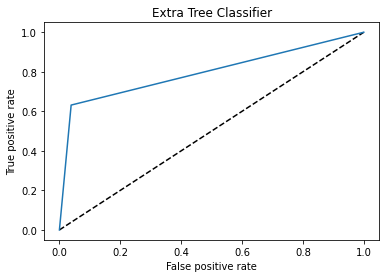

In [122]:
plt.plot([0,1],[0,1],'k--')
plt.plot(fpr,tpr,label='Extra Tree Classifier(area=%0.2f)'%roc_auc)
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('Extra Tree Classifier')
plt.show()

In [123]:
auc_score=roc_auc_score(y_test,final.predict(x_test))
print('Auc score:',auc_score)

Auc score: 0.7965180903684767


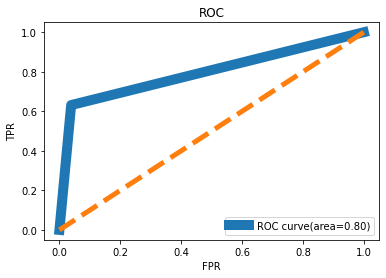

In [124]:
fpr, tpr, thresholds = roc_curve (y_test,pred)
roc_auc = auc(fpr,tpr)

plt.figure()
plt.plot(fpr,tpr,lw=10,label='ROC curve(area=%0.2f)'%roc_auc)

plt.plot([0,1],[0,1],lw=5,linestyle='--')
#plt.xlim([0.0,1.0])
#plt.ylim([0.0,1.05])
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.title('ROC')
plt.legend(loc='lower right')
plt.show()

We can see that our ROC curve is 88% and this curve is very good and our model work very well

# Saving the model using .pkl

In [125]:
import pickle
pickle.dump(final,open('Rainfall Weather Forecasting Prediction','wb'))

In [126]:
loaded_model= pickle.load(open("Rainfall Weather Forecasting Prediction","rb"))
prediction= loaded_model.predict(x_test)
a= np.array(y_test)
df_pred=pd.DataFrame()
df_pred['predicted']= prediction
df_pred['actual']= a
df_pred

,predicted,actual
0,0,0
1,0,0
2,0,0
3,0,0
4,0,0
...,...,...
2440,0,0
2441,0,0
2442,0,0
2443,0,0
